In [363]:
import pandas as pd
import seaborn as sn
import matplotlib.pyplot as plt

In [364]:
my_df=pd.read_csv('covid-vaccination-vs-death_ratio.csv')   # covid vaccination proccess per country


thirdworld_df=pd.read_csv("list_of_least_developed_countries_as_of_december_2018_uo7hWUb.csv")  # third world countries

variants_df=pd.read_csv("covid-variants.csv")   # https://www.kaggle.com/gpreda/covid-19-variants-in-romania #covid variants

In [365]:
print(min(my_df['date']))
print(max(my_df['date']))


print("\n")
print(min(variants_df['date']))
print(max(variants_df['date']))
# print(min(df_merged['date']))
# print(max(df_merged['date']))

2020-12-13
2021-12-26


2020-05-11
2022-01-05


In [366]:
variants_df

,location,date,variant,num_sequences,perc_sequences,num_sequences_total
0,Angola,2020-07-06,Alpha,0,0.0,3
1,Angola,2020-07-06,B.1.1.277,0,0.0,3
2,Angola,2020-07-06,B.1.1.302,0,0.0,3
3,Angola,2020-07-06,B.1.1.519,0,0.0,3
4,Angola,2020-07-06,B.1.160,0,0.0,3
...,...,...,...,...,...,...
100411,Zimbabwe,2021-11-01,Omicron,0,0.0,6
100412,Zimbabwe,2021-11-01,S:677H.Robin1,0,0.0,6
100413,Zimbabwe,2021-11-01,S:677P.Pelican,0,0.0,6
100414,Zimbabwe,2021-11-01,others,0,0.0,6


In [367]:
my_df
# my_df.isna().sum()

,Unnamed: 0,country,iso_code,date,total_vaccinations,people_vaccinated,people_fully_vaccinated,New_deaths,population,ratio
0,0,Afghanistan,AFG,2021-05-11,504502.0,448878.0,55624.0,12,40295077.0,1.113977
1,1,Afghanistan,AFG,2021-05-20,547901.0,470341.0,77560.0,10,40295077.0,1.167242
2,2,Afghanistan,AFG,2021-05-24,573277.0,476367.0,96910.0,10,40295077.0,1.182197
3,3,Afghanistan,AFG,2021-05-26,590454.0,479372.0,111082.0,19,40295077.0,1.189654
4,4,Afghanistan,AFG,2021-05-27,593313.0,479574.0,113739.0,14,40295077.0,1.190155
...,...,...,...,...,...,...,...,...,...,...
26618,26618,Zimbabwe,ZWE,2021-12-22,7167610.0,4078945.0,3088665.0,14,15209563.0,26.818292
26619,26619,Zimbabwe,ZWE,2021-12-23,7188128.0,4089315.0,3098813.0,9,15209563.0,26.886473
26620,26620,Zimbabwe,ZWE,2021-12-24,7200776.0,4095685.0,3105091.0,27,15209563.0,26.928354
26621,26621,Zimbabwe,ZWE,2021-12-25,7209049.0,4100069.0,3108980.0,16,15209563.0,26.957178


In [368]:
my_df.loc[my_df["country"]=="Angola"]

,Unnamed: 0,country,iso_code,date,total_vaccinations,people_vaccinated,people_fully_vaccinated,New_deaths,population,ratio
221,221,Angola,AGO,2021-05-12,626572.0,586377.0,40195.0,3,34472807.0,1.700984
222,222,Angola,AGO,2021-05-18,681502.0,606287.0,75215.0,18,34472807.0,1.758740
223,223,Angola,AGO,2021-05-21,757535.0,630984.0,126551.0,8,34472807.0,1.830382
224,224,Angola,AGO,2021-05-26,859979.0,663049.0,196930.0,4,34472807.0,1.923397
225,225,Angola,AGO,2021-05-31,909215.0,679034.0,230181.0,7,34472807.0,1.969767
226,226,Angola,AGO,2021-06-08,1115919.0,740289.0,375630.0,3,34472807.0,2.147458
227,227,Angola,AGO,2021-06-10,1222630.0,774926.0,447704.0,8,34472807.0,2.247934
228,228,Angola,AGO,2021-06-15,1314375.0,822109.0,492266.0,5,34472807.0,2.384804
229,229,Angola,AGO,2021-06-20,1380174.0,866381.0,513793.0,3,34472807.0,2.513230
230,230,Angola,AGO,2021-06-24,1432699.0,909119.0,523580.0,3,34472807.0,2.637206


In [369]:
my_df['total_deaths'] = my_df.groupby(['country'])['New_deaths'].cumsum(axis=0) # accumulate deaths per day
my_df['daily_vac'] = my_df.groupby(['country'])['total_vaccinations'].diff().fillna(my_df['total_vaccinations'])
my_df

,Unnamed: 0,country,iso_code,date,total_vaccinations,people_vaccinated,people_fully_vaccinated,New_deaths,population,ratio,total_deaths,daily_vac
0,0,Afghanistan,AFG,2021-05-11,504502.0,448878.0,55624.0,12,40295077.0,1.113977,12,504502.0
1,1,Afghanistan,AFG,2021-05-20,547901.0,470341.0,77560.0,10,40295077.0,1.167242,22,43399.0
2,2,Afghanistan,AFG,2021-05-24,573277.0,476367.0,96910.0,10,40295077.0,1.182197,32,25376.0
3,3,Afghanistan,AFG,2021-05-26,590454.0,479372.0,111082.0,19,40295077.0,1.189654,51,17177.0
4,4,Afghanistan,AFG,2021-05-27,593313.0,479574.0,113739.0,14,40295077.0,1.190155,65,2859.0
...,...,...,...,...,...,...,...,...,...,...,...,...
26618,26618,Zimbabwe,ZWE,2021-12-22,7167610.0,4078945.0,3088665.0,14,15209563.0,26.818292,2802,15664.0
26619,26619,Zimbabwe,ZWE,2021-12-23,7188128.0,4089315.0,3098813.0,9,15209563.0,26.886473,2811,20518.0
26620,26620,Zimbabwe,ZWE,2021-12-24,7200776.0,4095685.0,3105091.0,27,15209563.0,26.928354,2838,12648.0
26621,26621,Zimbabwe,ZWE,2021-12-25,7209049.0,4100069.0,3108980.0,16,15209563.0,26.957178,2854,8273.0


In [370]:
# my_df.loc[my_df["country"]=="Zimbabwe"]

In [371]:
# delete from my df dates that dont exist at variants dataset and vise versa
# 2020-12-13
# 2021-12-26

# 2020-12-07
# 2022-01-05


# me to deftero dataset afto
# my_final_df = my_df3.loc[(my_df3['date'] <= '2022-01-05')]
# final_variants_df = variants_df.loc[(variants_df['date'] >= '2020-12-02')]


# me to proto dataset afto


mask = (variants_df['date'] >= '2020-12-13') & (variants_df['date'] <= '2021-12-26')


final_variants_df = variants_df.loc[mask]


mask2 = (my_df['date'] >= '2020-12-21') & (my_df['date'] <= '2021-12-13')


final_variants_df = variants_df.loc[mask]

my_df = my_df.loc[mask2]


# print(min(my_final_df['date']))
# print(max(my_final_df['date']))



print(min(my_df['date']))
print(max(my_df['date']))
print("\n")
print(min(variants_df['date']))
print(max(variants_df['date']))
print("\n")
print(min(final_variants_df['date']))
print(max(final_variants_df['date']))

2020-12-21
2021-12-13


2020-05-11
2022-01-05


2020-12-21
2021-12-13


In [372]:
# df_merged = pd.merge(my_df3, variants_df, on=['date', 'location'], how='inner')


my_df.rename(columns={'country': 'location'}, inplace=True)

#my_df




/home/kostas/anaconda3/lib/python3.7/site-packages/pandas/core/frame.py:4449: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


In [373]:
#my_df.loc[my_df["location"]=="Bangladesh"]

In [374]:
df_merged = pd.merge(my_df, final_variants_df, on=['date', 'location'], how='inner')


df_merged

# print(min(df_merged['date']))
# print(max(df_merged['date']))

,Unnamed: 0,location,iso_code,date,total_vaccinations,people_vaccinated,people_fully_vaccinated,New_deaths,population,ratio,total_deaths,daily_vac,variant,num_sequences,perc_sequences,num_sequences_total
0,225,Angola,AGO,2021-05-31,909215.0,679034.0,230181.0,7,34472807.0,1.969767,40,49236.0,Alpha,7,100.0,7
1,225,Angola,AGO,2021-05-31,909215.0,679034.0,230181.0,7,34472807.0,1.969767,40,49236.0,B.1.1.277,0,0.0,7
2,225,Angola,AGO,2021-05-31,909215.0,679034.0,230181.0,7,34472807.0,1.969767,40,49236.0,B.1.1.302,0,0.0,7
3,225,Angola,AGO,2021-05-31,909215.0,679034.0,230181.0,7,34472807.0,1.969767,40,49236.0,B.1.1.519,0,0.0,7
4,225,Angola,AGO,2021-05-31,909215.0,679034.0,230181.0,7,34472807.0,1.969767,40,49236.0,B.1.160,0,0.0,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32083,26568,Zimbabwe,ZWE,2021-11-01,5923317.0,3322864.0,2600453.0,1,15209563.0,21.847202,2662,11729.0,Omicron,0,0.0,6
32084,26568,Zimbabwe,ZWE,2021-11-01,5923317.0,3322864.0,2600453.0,1,15209563.0,21.847202,2662,11729.0,S:677H.Robin1,0,0.0,6
32085,26568,Zimbabwe,ZWE,2021-11-01,5923317.0,3322864.0,2600453.0,1,15209563.0,21.847202,2662,11729.0,S:677P.Pelican,0,0.0,6
32086,26568,Zimbabwe,ZWE,2021-11-01,5923317.0,3322864.0,2600453.0,1,15209563.0,21.847202,2662,11729.0,others,0,0.0,6


In [375]:
thirdworld_df
#thirdcountries = thirdworld_df['Country Name'].tolist()


,Country name,di_id,LDC status marker (1=LDC)
0,Afghanistan,AF,1
1,Angola,AO,1
2,Bangladesh,BD,1
3,Benin,BJ,1
4,Bhutan,BT,1
5,Burkina Faso,BF,1
6,Burundi,BI,1
7,Cambodia,KH,1
8,Central African Republic,CF,1
9,Chad,TD,1


In [376]:
thirdcountries = thirdworld_df['Country name'].tolist()
df_merged['Third world']=False

In [377]:
df_merged

,Unnamed: 0,location,iso_code,date,total_vaccinations,people_vaccinated,people_fully_vaccinated,New_deaths,population,ratio,total_deaths,daily_vac,variant,num_sequences,perc_sequences,num_sequences_total,Third world
0,225,Angola,AGO,2021-05-31,909215.0,679034.0,230181.0,7,34472807.0,1.969767,40,49236.0,Alpha,7,100.0,7,False
1,225,Angola,AGO,2021-05-31,909215.0,679034.0,230181.0,7,34472807.0,1.969767,40,49236.0,B.1.1.277,0,0.0,7,False
2,225,Angola,AGO,2021-05-31,909215.0,679034.0,230181.0,7,34472807.0,1.969767,40,49236.0,B.1.1.302,0,0.0,7,False
3,225,Angola,AGO,2021-05-31,909215.0,679034.0,230181.0,7,34472807.0,1.969767,40,49236.0,B.1.1.519,0,0.0,7,False
4,225,Angola,AGO,2021-05-31,909215.0,679034.0,230181.0,7,34472807.0,1.969767,40,49236.0,B.1.160,0,0.0,7,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32083,26568,Zimbabwe,ZWE,2021-11-01,5923317.0,3322864.0,2600453.0,1,15209563.0,21.847202,2662,11729.0,Omicron,0,0.0,6,False
32084,26568,Zimbabwe,ZWE,2021-11-01,5923317.0,3322864.0,2600453.0,1,15209563.0,21.847202,2662,11729.0,S:677H.Robin1,0,0.0,6,False
32085,26568,Zimbabwe,ZWE,2021-11-01,5923317.0,3322864.0,2600453.0,1,15209563.0,21.847202,2662,11729.0,S:677P.Pelican,0,0.0,6,False
32086,26568,Zimbabwe,ZWE,2021-11-01,5923317.0,3322864.0,2600453.0,1,15209563.0,21.847202,2662,11729.0,others,0,0.0,6,False


In [378]:
thirdcountries

['Afghanistan',
 'Angola',
 'Bangladesh',
 'Benin',
 'Bhutan',
 'Burkina Faso',
 'Burundi',
 'Cambodia',
 'Central African Republic',
 'Chad',
 'Comoros',
 'Democratic Republic of the Congo',
 'Djibouti',
 'Eritrea',
 'Ethiopia',
 'Gambia',
 'Guinea',
 'Guinea-Bissau',
 'Haiti',
 'Kiribati',
 'Laos',
 'Lesotho',
 'Liberia',
 'Madagascar',
 'Malawi',
 'Mali',
 'Mauritania',
 'Mozambique',
 'Myanmar',
 'Nepal',
 'Niger',
 'Rwanda',
 'S�o Tom� and Pr�ncipe',
 'Senegal',
 'Sierra Leone',
 'Solomon Islands',
 'Somalia',
 'South Sudan',
 'Sudan',
 'Timor-Leste',
 'Togo',
 'Tuvalu',
 'Uganda',
 'Tanzania',
 'Vanuatu',
 'Yemen',
 'Zambia']

In [379]:
for index, row in df_merged.iterrows():
    print(row["location"])
    print("\n")
    if row["location"] in thirdcountries:
        print(row["location"])
        df_merged.at[index,'Third world'] = True
        #row["Third world"]=1

Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola


Angola
Angola



Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Aruba


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia


Australia




Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria


Austria





Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bangladesh


Bangladesh
Bang

Belgium


Belgium


Belgium


Belgium


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Belize


Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Benin
Benin


Be



Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Bulgaria


Cambodia


Cambodia
Cambodia


Cambodia
Cambodia


Cambodia
Cambodia


Cambodia
Cambodia


Cambodia
Cambodia


Cambodia
Cambodia


Cambodia
Cambodia


Cambodia
Ca

Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


Canada


C



Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica


Costa Rica



Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Denmark


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia


Estonia




Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany


Germany




Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Hungary


Iceland


Iceland


Iceland


Iceland


Iceland


Iceland


Iceland


Iceland


Iceland


Iceland


Iceland


Iceland


Iceland




Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland


Ireland




Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy


Italy




Jordan


Jordan


Jordan


Jordan


Jordan


Jordan


Jordan


Jordan


Jordan


Jordan


Jordan


Jordan


Jordan


Jordan


Jordan


Jordan


Jordan


Jordan


Jordan


Jordan


Jordan


Jordan


Jordan


Jordan


Jordan


Jordan


Jordan


Jordan


Jordan


Jordan


Jordan


Jordan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan


Kazakhstan

Lebanon


Lebanon


Lebanon


Lebanon


Lebanon


Lebanon


Lebanon


Lebanon


Lebanon


Lebanon


Lebanon


Lebanon


Lebanon


Lebanon


Lebanon


Lebanon


Lebanon


Lebanon


Lebanon


Lebanon


Lebanon


Lebanon


Lebanon


Lebanon


Lebanon


Lebanon


Lebanon


Lebanon


Lebanon


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liechtenstein


Liecht

Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia


Malaysia




Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico


Mexico




Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco


Morocco




New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Zealand


New Ze

Norway


Norway


Norway


Norway


Norway


Norway


Norway


Norway


Norway


Norway


Norway


Norway


Norway


Norway


Norway


Norway


Norway


Norway


Norway


Norway


Norway


Norway


Norway


Norway


Norway


Norway


Norway


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


Oman


O

Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Peru


Philippines


Philippines


Philippines


Philippines


Philippines


Philippines


Philippines


Philippines


Philippines


Philippines


Philippines


Philippines


Philippines


Philippines


Philippines


Philippines


Philippines


Philippines


Philippines


Philippines


Philippines


Philippines


Philippines


Philippines


Philippines


Philip

Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania


Romania





Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Slovakia


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain


Spain






Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Switzerland


Swit


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine


Ukraine



In [380]:

for col in df_merged.columns:
    print(col)
    
    
df=df_merged
df.describe()

Unnamed: 0
location
iso_code
date
total_vaccinations
people_vaccinated
people_fully_vaccinated
New_deaths
population
ratio
total_deaths
daily_vac
variant
num_sequences
perc_sequences
num_sequences_total
Third world


,Unnamed: 0,total_vaccinations,people_vaccinated,people_fully_vaccinated,New_deaths,population,ratio,total_deaths,daily_vac,num_sequences,perc_sequences,num_sequences_total
count,32088.000000,3.208800e+04,3.208800e+04,3.208800e+04,32088.000000,3.208800e+04,32088.000000,32088.000000,3.208800e+04,32088.000000,32088.000000,32088.000000
mean,12821.818250,2.664335e+07,1.674650e+07,9.888725e+06,90.477188,5.796847e+07,34.985953,18157.222139,2.296618e+05,66.205529,4.736568,1458.188482
std,7220.148161,9.083542e+07,6.168041e+07,3.028737e+07,307.501210,1.816135e+08,27.114873,47945.785812,7.808295e+05,647.196884,18.162100,3083.997113
min,225.000000,1.000000e+00,1.000000e+00,1.000000e+00,0.000000,3.825000e+04,0.000011,0.000000,0.000000e+00,0.000000,-0.010000,1.000000
25%,6614.000000,8.806740e+05,6.136770e+05,2.639620e+05,2.000000,5.004769e+06,8.592941,454.000000,8.280000e+03,0.000000,0.000000,57.000000
50%,12680.000000,4.519495e+06,2.899188e+06,1.614312e+06,13.000000,1.165456e+07,31.459244,2813.000000,3.937800e+04,0.000000,0.000000,330.000000
75%,19023.000000,1.743081e+07,1.067015e+07,6.773123e+06,50.000000,4.581177e+07,59.662602,12215.000000,1.637980e+05,0.000000,0.000000,1546.000000
max,26568.000000,1.335466e+09,8.179076e+08,5.175580e+08,4106.000000,1.400144e+09,98.538732,387877.000000,1.350297e+07,28791.000000,100.000000,32547.000000


In [381]:
# df['vacc_rat'] = my_df['people_fully_vaccinated']/my_df['population']
# df['new_death_rat'] = my_df['New_deaths']/my_df['population']



In [382]:

df

,Unnamed: 0,location,iso_code,date,total_vaccinations,people_vaccinated,people_fully_vaccinated,New_deaths,population,ratio,total_deaths,daily_vac,variant,num_sequences,perc_sequences,num_sequences_total,Third world
0,225,Angola,AGO,2021-05-31,909215.0,679034.0,230181.0,7,34472807.0,1.969767,40,49236.0,Alpha,7,100.0,7,True
1,225,Angola,AGO,2021-05-31,909215.0,679034.0,230181.0,7,34472807.0,1.969767,40,49236.0,B.1.1.277,0,0.0,7,True
2,225,Angola,AGO,2021-05-31,909215.0,679034.0,230181.0,7,34472807.0,1.969767,40,49236.0,B.1.1.302,0,0.0,7,True
3,225,Angola,AGO,2021-05-31,909215.0,679034.0,230181.0,7,34472807.0,1.969767,40,49236.0,B.1.1.519,0,0.0,7,True
4,225,Angola,AGO,2021-05-31,909215.0,679034.0,230181.0,7,34472807.0,1.969767,40,49236.0,B.1.160,0,0.0,7,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32083,26568,Zimbabwe,ZWE,2021-11-01,5923317.0,3322864.0,2600453.0,1,15209563.0,21.847202,2662,11729.0,Omicron,0,0.0,6,False
32084,26568,Zimbabwe,ZWE,2021-11-01,5923317.0,3322864.0,2600453.0,1,15209563.0,21.847202,2662,11729.0,S:677H.Robin1,0,0.0,6,False
32085,26568,Zimbabwe,ZWE,2021-11-01,5923317.0,3322864.0,2600453.0,1,15209563.0,21.847202,2662,11729.0,S:677P.Pelican,0,0.0,6,False
32086,26568,Zimbabwe,ZWE,2021-11-01,5923317.0,3322864.0,2600453.0,1,15209563.0,21.847202,2662,11729.0,others,0,0.0,6,False


In [383]:
total_vaccinations = df[['location','date','New_deaths','total_vaccinations','daily_vac','total_deaths', 'Third world', 'people_fully_vaccinated','population','num_sequences','num_sequences_total']]


In [384]:
total_vaccinations.corr(method ='kendall')


,New_deaths,total_vaccinations,daily_vac,total_deaths,Third world,people_fully_vaccinated,population,num_sequences,num_sequences_total
New_deaths,1.000000,0.261736,0.327151,0.460527,-0.052229,0.215248,0.448857,0.071966,0.194049
total_vaccinations,0.261736,1.000000,0.580566,0.561024,-0.000428,0.906207,0.525808,0.023632,0.341992
daily_vac,0.327151,0.580566,1.000000,0.415039,0.034754,0.517930,0.572775,0.075405,0.254120
total_deaths,0.460527,0.561024,0.415039,1.000000,-0.106039,0.536199,0.488059,0.081009,0.364852
Third world,-0.052229,-0.000428,0.034754,-0.106039,1.000000,0.002004,0.102547,-0.069999,-0.193006
people_fully_vaccinated,0.215248,0.906207,0.517930,0.536199,0.002004,1.000000,0.457520,0.003196,0.325394
population,0.448857,0.525808,0.572775,0.488059,0.102547,0.457520,1.000000,0.081643,0.241523
num_sequences,0.071966,0.023632,0.075405,0.081009,-0.069999,0.003196,0.081643,1.000000,0.162153
num_sequences_total,0.194049,0.341992,0.254120,0.364852,-0.193006,0.325394,0.241523,0.162153,1.000000


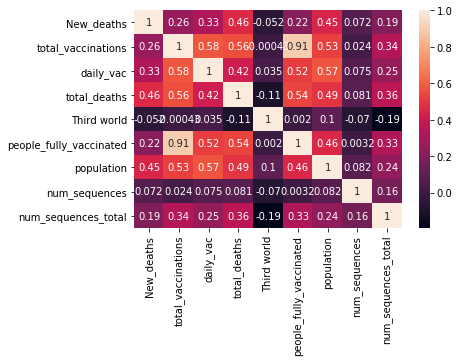

In [385]:
corrMatrix = total_vaccinations.corr(method ='kendall')
sn.heatmap(corrMatrix, annot=True)
plt.show()

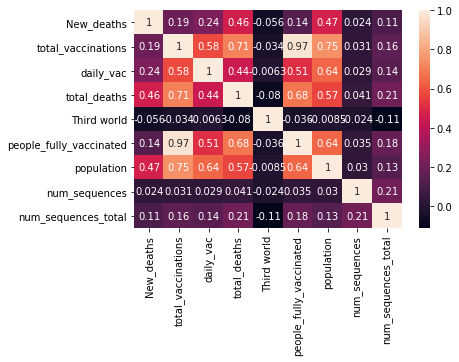

In [386]:
corrMatrix = total_vaccinations.corr(method ='pearson')
sn.heatmap(corrMatrix, annot=True)
plt.show()

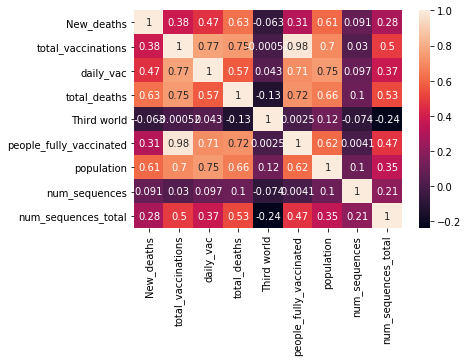

In [387]:
corrMatrix = total_vaccinations.corr(method ='spearman')
sn.heatmap(corrMatrix, annot=True)
plt.show()

In [388]:
popsum_df=total_vaccinations.groupby('Third world')['population'].sum()
popsum_df

Third world
False    1.764476e+12
True     9.561620e+10
Name: population, dtype: float64

In [389]:
deaths=total_vaccinations
vacc=total_vaccinations
variants=total_vaccinations

In [390]:
#sum_df = df.groupby(['date','Third world']).agg({'New_deaths': 'sum'}) 
deaths=df.groupby(['date','Third world'], as_index=False)['New_deaths'].sum()

deaths['New_deaths_per']=0

vacc=df.groupby(['date','Third world'], as_index=False)['daily_vac'].sum()

vacc['Daily_vac_per']=0

varr=df.groupby(['date','Third world'], as_index=False)['num_sequences_total'].sum()

varr['num_sequences_per']=0


In [396]:
for index, row in deaths.iterrows():
    if row['Third world']==True:
        deaths.at[index , 'New_deaths_per'] =row['New_deaths']/9.561620
        #print(row['New_deaths']/9.561620)
    else:
        deaths.at[index, 'New_deaths_per']=row['New_deaths']/176.4476
        
for index, row in vacc.iterrows():
    if row['Third world']==True:
        vacc.at[index , 'Daily_vac_per'] =row['daily_vac']/9.561620
        #print(row['New_deaths']/9.561620)
    else:
        vacc.at[index, 'Daily_vac_per']=row['daily_vac']/176.4476

        
for index, row in varr.iterrows():
    if row['Third world']==True:
        varr.at[index , 'num_sequences_per'] =row['num_sequences_total']/9.561620
        #print(row['New_deaths']/9.561620)
    else:
        varr.at[index, 'num_sequences_per']=row['num_sequences_total']/176.4476

In [397]:
# sum_df.sort_values(by=['date'])
# for col in sum_df.columns:
#     print(col)
# sum_df.dtypes

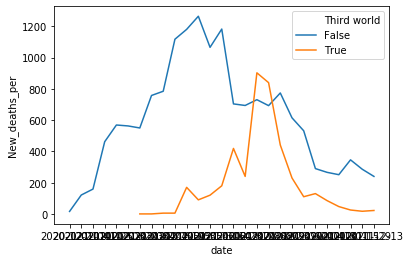

In [398]:
import seaborn as sns

sns.lineplot(data=deaths, x="date", y="New_deaths_per", hue="Third world")




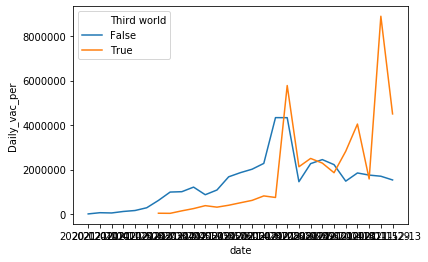

In [399]:
sns.lineplot(data=vacc, x="date", y="Daily_vac_per", hue="Third world")


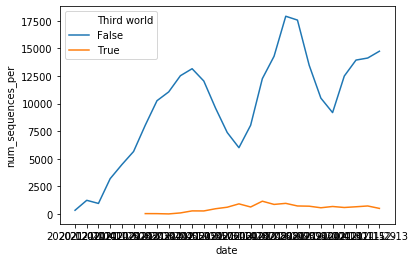

In [402]:
sns.lineplot(data=varr, x="date", y="num_sequences_per", hue="Third world")


In [404]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import pandas_alive

In [415]:
dates=df['date']
type(df)
dates=dates.drop_duplicates()
dates
dates_array=dates.values
for_anime=pd.DataFrame()   



for index, row in df.iterrows():
    print(row)
  


Unnamed: 0                        225
location                       Angola
iso_code                          AGO
date                       2021-05-31
total_vaccinations           909215.0
people_vaccinated            679034.0
people_fully_vaccinated      230181.0
New_deaths                          7
population                 34472807.0
ratio                        1.969767
total_deaths                       40
daily_vac                     49236.0
variant                         Alpha
num_sequences                       7
perc_sequences                  100.0
num_sequences_total                 7
Third world                      True
Name: 0, dtype: object
Unnamed: 0                        225
location                       Angola
iso_code                          AGO
date                       2021-05-31
total_vaccinations           909215.0
people_vaccinated            679034.0
people_fully_vaccinated      230181.0
New_deaths                          7
population                 

Name: 324, dtype: object
Unnamed: 0                        475
location                    Argentina
iso_code                          ARG
date                       2021-05-31
total_vaccinations         12257297.0
people_vaccinated           9476406.0
people_fully_vaccinated     2780891.0
New_deaths                        415
population                 45811768.0
ratio                       20.685528
total_deaths                    31092
daily_vac                    137396.0
variant                           Eta
num_sequences                       0
perc_sequences                    0.0
num_sequences_total               301
Third world                     False
Name: 325, dtype: object
Unnamed: 0                        475
location                    Argentina
iso_code                          ARG
date                       2021-05-31
total_vaccinations         12257297.0
people_vaccinated           9476406.0
people_fully_vaccinated     2780891.0
New_deaths                        415


Name: 600, dtype: object
Unnamed: 0                        648
location                    Argentina
iso_code                          ARG
date                       2021-11-29
total_vaccinations         68134307.0
people_vaccinated          36598131.0
people_fully_vaccinated    29512760.0
New_deaths                         12
population                 45811768.0
ratio                       79.888056
total_deaths                    69858
daily_vac                    352874.0
variant                     B.1.1.277
num_sequences                       0
perc_sequences                    0.0
num_sequences_total               117
Third world                     False
Name: 601, dtype: object
Unnamed: 0                        648
location                    Argentina
iso_code                          ARG
date                       2021-11-29
total_vaccinations         68134307.0
people_vaccinated          36598131.0
people_fully_vaccinated    29512760.0
New_deaths                         12


Name: 929, dtype: object
Unnamed: 0                        831
location                        Aruba
iso_code                          ABW
date                       2021-09-20
total_vaccinations           154700.0
people_vaccinated             80707.0
people_fully_vaccinated       73993.0
New_deaths                          0
population                   107204.0
ratio                       75.283572
total_deaths                       52
daily_vac                       253.0
variant                            Mu
num_sequences                       0
perc_sequences                    0.0
num_sequences_total               140
Third world                     False
Name: 930, dtype: object
Unnamed: 0                        831
location                        Aruba
iso_code                          ABW
date                       2021-09-20
total_vaccinations           154700.0
people_vaccinated             80707.0
people_fully_vaccinated       73993.0
New_deaths                          0


Name: 1203, dtype: object
Unnamed: 0                       1001
location                    Australia
iso_code                          AUS
date                       2021-05-31
total_vaccinations          4362739.0
people_vaccinated           3856485.0
people_fully_vaccinated      506254.0
New_deaths                          0
population                 25934634.0
ratio                       14.870019
total_deaths                        1
daily_vac                    119139.0
variant                       B.1.160
num_sequences                       0
perc_sequences                    0.0
num_sequences_total               108
Third world                     False
Name: 1204, dtype: object
Unnamed: 0                       1001
location                    Australia
iso_code                          AUS
date                       2021-05-31
total_vaccinations          4362739.0
people_vaccinated           3856485.0
people_fully_vaccinated      506254.0
New_deaths                          

Name: 1481, dtype: object
Unnamed: 0                       1153
location                    Australia
iso_code                          AUS
date                       2021-11-01
total_vaccinations         35825241.0
people_vaccinated          19100734.0
people_fully_vaccinated    16678894.0
New_deaths                         12
population                 25934634.0
ratio                       73.649522
total_deaths                      825
daily_vac                    222150.0
variant                            Mu
num_sequences                       0
perc_sequences                    0.0
num_sequences_total              1883
Third world                     False
Name: 1482, dtype: object
Unnamed: 0                       1153
location                    Australia
iso_code                          AUS
date                       2021-11-01
total_vaccinations         35825241.0
people_vaccinated          19100734.0
people_fully_vaccinated    16678894.0
New_deaths                         1

Name: 1801, dtype: object
Unnamed: 0                       1360
location                      Austria
iso_code                          AUT
date                       2021-06-14
total_vaccinations          6459632.0
people_vaccinated           4300347.0
people_fully_vaccinated     2242473.0
New_deaths                          4
population                  9062176.0
ratio                       47.453801
total_deaths                     3526
daily_vac                     49624.0
variant                     B.1.1.302
num_sequences                       0
perc_sequences                    0.0
num_sequences_total               398
Third world                     False
Name: 1802, dtype: object
Unnamed: 0                       1360
location                      Austria
iso_code                          AUT
date                       2021-06-14
total_vaccinations          6459632.0
people_vaccinated           4300347.0
people_fully_vaccinated     2242473.0
New_deaths                          

Name: 2084, dtype: object
Unnamed: 0                           1514
location                          Austria
iso_code                              AUT
date                           2021-11-15
total_vaccinations             12421097.0
people_vaccinated               6170567.0
people_fully_vaccinated         5784630.0
New_deaths                             47
population                      9062176.0
ratio                            68.09145
total_deaths                         4567
daily_vac                         71161.0
variant                    S:677P.Pelican
num_sequences                           0
perc_sequences                        0.0
num_sequences_total                   561
Third world                         False
Name: 2085, dtype: object
Unnamed: 0                       1514
location                      Austria
iso_code                          AUT
date                       2021-11-15
total_vaccinations         12421097.0
people_vaccinated           6170567.0
people

Name: 2359, dtype: object
Unnamed: 0                       1960
location                      Bahrain
iso_code                          BHR
date                       2021-07-26
total_vaccinations          2278934.0
people_vaccinated           1103611.0
people_fully_vaccinated     1045871.0
New_deaths                          1
population                  1771444.0
ratio                       62.300078
total_deaths                      921
daily_vac                      4398.0
variant                       B.1.367
num_sequences                       0
perc_sequences                    0.0
num_sequences_total               106
Third world                     False
Name: 2360, dtype: object
Unnamed: 0                       1960
location                      Bahrain
iso_code                          BHR
date                       2021-07-26
total_vaccinations          2278934.0
people_vaccinated           1103611.0
people_fully_vaccinated     1045871.0
New_deaths                          

Name: 2635, dtype: object
Unnamed: 0                          2167
location                      Bangladesh
iso_code                             BGD
date                          2021-06-28
total_vaccinations            10099562.0
people_vaccinated              5823245.0
people_fully_vaccinated        4276317.0
New_deaths                           104
population                   167108159.0
ratio                           3.484716
total_deaths                        3206
daily_vac                         1917.0
variant                    S:677H.Robin1
num_sequences                          0
perc_sequences                       0.0
num_sequences_total                  112
Third world                         True
Name: 2636, dtype: object
Unnamed: 0                           2167
location                       Bangladesh
iso_code                              BGD
date                           2021-06-28
total_vaccinations             10099562.0
people_vaccinated               5823245.0

Name: 2964, dtype: object
Unnamed: 0                       2571
location                      Belgium
iso_code                          BEL
date                       2021-01-25
total_vaccinations           263067.0
people_vaccinated            261887.0
people_fully_vaccinated        1594.0
New_deaths                         39
population                 11654555.0
ratio                        2.247079
total_deaths                     1567
daily_vac                     11468.0
variant                           Eta
num_sequences                       2
perc_sequences                   0.15
num_sequences_total              1378
Third world                     False
Name: 2965, dtype: object
Unnamed: 0                       2571
location                      Belgium
iso_code                          BEL
date                       2021-01-25
total_vaccinations           263067.0
people_vaccinated            261887.0
people_fully_vaccinated        1594.0
New_deaths                         3

Name: 3277, dtype: object
Unnamed: 0                       2753
location                      Belgium
iso_code                          BEL
date                       2021-07-26
total_vaccinations         14034736.0
people_vaccinated           7974528.0
people_fully_vaccinated     6384850.0
New_deaths                          2
population                 11654555.0
ratio                       68.424131
total_deaths                     5812
daily_vac                    118470.0
variant                         Gamma
num_sequences                      58
perc_sequences                   1.46
num_sequences_total              3960
Third world                     False
Name: 3278, dtype: object
Unnamed: 0                       2753
location                      Belgium
iso_code                          BEL
date                       2021-07-26
total_vaccinations         14034736.0
people_vaccinated           7974528.0
people_fully_vaccinated     6384850.0
New_deaths                          

Name: 3591, dtype: object
Unnamed: 0                       2975
location                        Benin
iso_code                          BEN
date                       2021-06-28
total_vaccinations            46108.0
people_vaccinated             36188.0
people_fully_vaccinated        9920.0
New_deaths                          0
population                 12616014.0
ratio                        0.286842
total_deaths                        0
daily_vac                     19484.0
variant                         Kappa
num_sequences                       0
perc_sequences                    0.0
num_sequences_total                14
Third world                      True
Name: 3592, dtype: object
Unnamed: 0                       2975
location                        Benin
iso_code                          BEN
date                       2021-06-28
total_vaccinations            46108.0
people_vaccinated             36188.0
people_fully_vaccinated        9920.0
New_deaths                          

Name: 3878, dtype: object
Unnamed: 0                        3519
location                        Brazil
iso_code                           BRA
date                        2021-05-17
total_vaccinations          58714631.0
people_vaccinated           39284275.0
people_fully_vaccinated     19430356.0
New_deaths                        2087
population                 214708998.0
ratio                         18.29652
total_deaths                    208406
daily_vac                     779351.0
variant                           Iota
num_sequences                        0
perc_sequences                     0.0
num_sequences_total               3247
Third world                      False
Name: 3879, dtype: object
Unnamed: 0                        3519
location                        Brazil
iso_code                           BRA
date                        2021-05-17
total_vaccinations          58714631.0
people_vaccinated           39284275.0
people_fully_vaccinated     19430356.0
New_deaths  

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Unnamed: 0                          4610
location                          Canada
iso_code                             CAN
date                          2021-06-14
total_vaccinations            29680344.0
people_vaccinated             24689287.0
people_fully_vaccinated        4990517.0
New_deaths                            28
population                    38232693.0
ratio                          64.576374
total_deaths                       11760
daily_vac                       447675.0
variant                    S:677H.Robin1
num_sequences                          1
perc_sequences                      0.02
num_sequences_total                 4215
Third world                        False
Name: 5444, dtype: object
Unnamed: 0                           4610
location                           Canada
iso_code                              CAN
date                           2021-06-14
total_vaccinations             29680344.0
people_vaccinated              24689287.0
people_fully_vaccinated 

Name: 5774, dtype: object
Unnamed: 0                       4983
location                        Chile
iso_code                          CHL
date                       2021-01-25
total_vaccinations            66802.0
people_vaccinated             57023.0
people_fully_vaccinated        9779.0
New_deaths                         79
population                 19266005.0
ratio                        0.295977
total_deaths                      771
daily_vac                      1420.0
variant                          Iota
num_sequences                       0
perc_sequences                    0.0
num_sequences_total                59
Third world                     False
Name: 5775, dtype: object
Unnamed: 0                       4983
location                        Chile
iso_code                          CHL
date                       2021-01-25
total_vaccinations            66802.0
people_vaccinated             57023.0
people_fully_vaccinated        9779.0
New_deaths                         7

Name: 6078, dtype: object
Unnamed: 0                       5165
location                        Chile
iso_code                          CHL
date                       2021-07-26
total_vaccinations         25626723.0
people_vaccinated          13799197.0
people_fully_vaccinated    12332243.0
New_deaths                         68
population                 19266005.0
ratio                        71.62459
total_deaths                    17864
daily_vac                     56842.0
variant                       B.1.258
num_sequences                       0
perc_sequences                    0.0
num_sequences_total               568
Third world                     False
Name: 6079, dtype: object
Unnamed: 0                       5165
location                        Chile
iso_code                          CHL
date                       2021-07-26
total_vaccinations         25626723.0
people_vaccinated          13799197.0
people_fully_vaccinated    12332243.0
New_deaths                         6

Name: 6367, dtype: object
Unnamed: 0                       5342
location                     Colombia
iso_code                          COL
date                       2021-04-05
total_vaccinations          2479671.0
people_vaccinated           2056135.0
people_fully_vaccinated      423536.0
New_deaths                        155
population                 51469030.0
ratio                        3.994898
total_deaths                     3159
daily_vac                     71586.0
variant                       B.1.367
num_sequences                       0
perc_sequences                    0.0
num_sequences_total               160
Third world                     False
Name: 6368, dtype: object
Unnamed: 0                       5342
location                     Colombia
iso_code                          COL
date                       2021-04-05
total_vaccinations          2479671.0
people_vaccinated           2056135.0
people_fully_vaccinated      423536.0
New_deaths                        15

Name: 6699, dtype: object
Unnamed: 0                       5540
location                   Costa Rica
iso_code                          CRI
date                       2021-02-08
total_vaccinations            75113.0
people_vaccinated             46750.0
people_fully_vaccinated       28363.0
New_deaths                          8
population                  5161465.0
ratio                        0.905751
total_deaths                       64
daily_vac                     17412.0
variant                       B.1.160
num_sequences                       0
perc_sequences                    0.0
num_sequences_total                27
Third world                     False
Name: 6700, dtype: object
Unnamed: 0                       5540
location                   Costa Rica
iso_code                          CRI
date                       2021-02-08
total_vaccinations            75113.0
people_vaccinated             46750.0
people_fully_vaccinated       28363.0
New_deaths                          

Name: 6991, dtype: object
Unnamed: 0                       5574
location                   Costa Rica
iso_code                          CRI
date                       2021-09-20
total_vaccinations          5278407.0
people_vaccinated           3274461.0
people_fully_vaccinated     2003946.0
New_deaths                         42
population                  5161465.0
ratio                       63.440535
total_deaths                      537
daily_vac                    406322.0
variant                       B.1.367
num_sequences                       0
perc_sequences                    0.0
num_sequences_total                92
Third world                     False
Name: 6992, dtype: object
Unnamed: 0                       5574
location                   Costa Rica
iso_code                          CRI
date                       2021-09-20
total_vaccinations          5278407.0
people_vaccinated           3274461.0
people_fully_vaccinated     2003946.0
New_deaths                         4

Name: 7296, dtype: object
Unnamed: 0                       5650
location                      Croatia
iso_code                          HRV
date                       2021-05-17
total_vaccinations          1369969.0
people_vaccinated           1052032.0
people_fully_vaccinated      317937.0
New_deaths                         21
population                  4069710.0
ratio                       25.850294
total_deaths                     1999
daily_vac                     20522.0
variant                     B.1.1.277
num_sequences                       0
perc_sequences                    0.0
num_sequences_total               639
Third world                     False
Name: 7297, dtype: object
Unnamed: 0                       5650
location                      Croatia
iso_code                          HRV
date                       2021-05-17
total_vaccinations          1369969.0
people_vaccinated           1052032.0
people_fully_vaccinated      317937.0
New_deaths                         2

Name: 7603, dtype: object
Unnamed: 0                          5804
location                         Croatia
iso_code                             HRV
date                          2021-12-13
total_vaccinations             4406837.0
people_vaccinated              2229626.0
people_fully_vaccinated        2046615.0
New_deaths                            45
population                     4069710.0
ratio                          54.785869
total_deaths                        5077
daily_vac                        20234.0
variant                    S:677H.Robin1
num_sequences                          0
perc_sequences                       0.0
num_sequences_total                  935
Third world                        False
Name: 7604, dtype: object
Unnamed: 0                           5804
location                          Croatia
iso_code                              HRV
date                           2021-12-13
total_vaccinations              4406837.0
people_vaccinated               2229626.0

Name: 7890, dtype: object
Unnamed: 0                       6543
location                      Denmark
iso_code                          DNK
date                       2021-09-06
total_vaccinations          8639362.0
people_vaccinated           4409604.0
people_fully_vaccinated     4248830.0
New_deaths                          0
population                  5823953.0
ratio                       75.714965
total_deaths                      245
daily_vac                     10653.0
variant                       Omicron
num_sequences                       0
perc_sequences                    0.0
num_sequences_total              8743
Third world                     False
Name: 7891, dtype: object
Unnamed: 0                          6543
location                         Denmark
iso_code                             DNK
date                          2021-09-06
total_vaccinations             8639362.0
people_vaccinated              4409604.0
people_fully_vaccinated        4248830.0
New_deaths     

Name: 8202, dtype: object
Unnamed: 0                               6786
location                   Dominican Republic
iso_code                                  DOM
date                               2021-08-09
total_vaccinations                 10500107.0
people_vaccinated                   5631732.0
people_fully_vaccinated             4391693.0
New_deaths                                  0
population                         11006612.0
ratio                               51.166808
total_deaths                              496
daily_vac                             47977.0
variant                               Omicron
num_sequences                               0
perc_sequences                            0.0
num_sequences_total                        29
Third world                             False
Name: 8203, dtype: object
Unnamed: 0                               6786
location                   Dominican Republic
iso_code                                  DOM
date                        

Name: 8524, dtype: object
Unnamed: 0                       7024
location                      Ecuador
iso_code                          ECU
date                       2021-05-17
total_vaccinations          2191821.0
people_vaccinated           1767464.0
people_fully_vaccinated      424357.0
New_deaths                          7
population                 18012297.0
ratio                        9.812541
total_deaths                     4809
daily_vac                     48026.0
variant                       B.1.177
num_sequences                       0
perc_sequences                    0.0
num_sequences_total               139
Third world                     False
Name: 8525, dtype: object
Unnamed: 0                       7024
location                      Ecuador
iso_code                          ECU
date                       2021-05-17
total_vaccinations          2191821.0
people_vaccinated           1767464.0
people_fully_vaccinated      424357.0
New_deaths                          

Name: 8827, dtype: object
Unnamed: 0                          7195
location                         Ecuador
iso_code                             ECU
date                          2021-11-15
total_vaccinations            23477052.0
people_vaccinated             13120241.0
people_fully_vaccinated       10590333.0
New_deaths                            17
population                    18012297.0
ratio                          72.840466
total_deaths                       17904
daily_vac                       105021.0
variant                    S:677H.Robin1
num_sequences                          0
perc_sequences                       0.0
num_sequences_total                  100
Third world                        False
Name: 8828, dtype: object
Unnamed: 0                           7195
location                          Ecuador
iso_code                              ECU
date                           2021-11-15
total_vaccinations             23477052.0
people_vaccinated              13120241.0

Name: 9125, dtype: object
Unnamed: 0                       7549
location                      Estonia
iso_code                          EST
date                       2021-02-22
total_vaccinations            91679.0
people_vaccinated             64364.0
people_fully_vaccinated       27877.0
New_deaths                          5
population                  1324450.0
ratio                        4.859678
total_deaths                      336
daily_vac                      2991.0
variant                       B.1.221
num_sequences                      48
perc_sequences                   8.51
num_sequences_total               564
Third world                     False
Name: 9126, dtype: object
Unnamed: 0                       7549
location                      Estonia
iso_code                          EST
date                       2021-02-22
total_vaccinations            91679.0
people_vaccinated             64364.0
people_fully_vaccinated       27877.0
New_deaths                          

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Unnamed: 0                        8964
location                       Germany
iso_code                           DEU
date                        2021-11-15
total_vaccinations         115414328.0
people_vaccinated           58385813.0
people_fully_vaccinated     56262185.0
New_deaths                          43
population                  83964589.0
ratio                        69.536234
total_deaths                     68293
daily_vac                     245764.0
variant                      B.1.1.519
num_sequences                        0
perc_sequences                     0.0
num_sequences_total              17801
Third world                      False
Name: 11067, dtype: object
Unnamed: 0                        8964
location                       Germany
iso_code                           DEU
date                        2021-11-15
total_vaccinations         115414328.0
people_vaccinated           58385813.0
people_fully_vaccinated     56262185.0
New_deaths                          

Name: 11398, dtype: object
Unnamed: 0                       9302
location                       Greece
iso_code                          GRC
date                       2021-05-03
total_vaccinations          3136791.0
people_vaccinated           2191449.0
people_fully_vaccinated      945331.0
New_deaths                          0
population                 10345024.0
ratio                       21.183605
total_deaths                     4328
daily_vac                     21452.0
variant                       non_who
num_sequences                     242
perc_sequences                  19.07
num_sequences_total              1269
Third world                     False
Name: 11399, dtype: object
Unnamed: 0                       9314
location                       Greece
iso_code                          GRC
date                       2021-05-17
total_vaccinations          4405618.0
people_vaccinated           2836972.0
people_fully_vaccinated     1624604.0
New_deaths                        

Name: 11707, dtype: object
Unnamed: 0                          9480
location                          Greece
iso_code                             GRC
date                          2021-11-01
total_vaccinations            12719596.0
people_vaccinated              6646463.0
people_fully_vaccinated        6379804.0
New_deaths                            44
population                    10345024.0
ratio                          64.247922
total_deaths                        9560
daily_vac                        28787.0
variant                    S:677H.Robin1
num_sequences                          0
perc_sequences                       0.0
num_sequences_total                  155
Third world                        False
Name: 11708, dtype: object
Unnamed: 0                           9480
location                           Greece
iso_code                              GRC
date                           2021-11-01
total_vaccinations             12719596.0
people_vaccinated               6646463

Name: 12008, dtype: object
Unnamed: 0                       9822
location                    Guatemala
iso_code                          GTM
date                       2021-08-09
total_vaccinations          2777441.0
people_vaccinated           2389325.0
people_fully_vaccinated      388116.0
New_deaths                         57
population                 18417406.0
ratio                        12.97319
total_deaths                     3791
daily_vac                     78576.0
variant                       B.1.620
num_sequences                       0
perc_sequences                    0.0
num_sequences_total                76
Third world                     False
Name: 12009, dtype: object
Unnamed: 0                       9822
location                    Guatemala
iso_code                          GTM
date                       2021-08-09
total_vaccinations          2777441.0
people_vaccinated           2389325.0
people_fully_vaccinated      388116.0
New_deaths                        

Name: 12316, dtype: object
Unnamed: 0                      10404
location                      Iceland
iso_code                          ISL
date                       2021-01-25
total_vaccinations            15220.0
people_vaccinated             10433.0
people_fully_vaccinated        4787.0
New_deaths                          0
population                   344455.0
ratio                        3.028843
total_deaths                        0
daily_vac                      9015.0
variant                       B.1.177
num_sequences                      28
perc_sequences                  33.33
num_sequences_total                84
Third world                     False
Name: 12317, dtype: object
Unnamed: 0                      10404
location                      Iceland
iso_code                          ISL
date                       2021-01-25
total_vaccinations            15220.0
people_vaccinated             10433.0
people_fully_vaccinated        4787.0
New_deaths                        

Name: 12618, dtype: object
Unnamed: 0                        10598
location                          India
iso_code                            IND
date                         2021-05-03
total_vaccinations          156082136.0
people_vaccinated           127696675.0
people_fully_vaccinated      28385461.0
New_deaths                         3417
population                 1400144310.0
ratio                          9.120251
total_deaths                      56772
daily_vac                     1870625.0
variant                         Omicron
num_sequences                         0
perc_sequences                      0.0
num_sequences_total                8086
Third world                       False
Name: 12619, dtype: object
Unnamed: 0                         10598
location                           India
iso_code                             IND
date                          2021-05-03
total_vaccinations           156082136.0
people_vaccinated            127696675.0
people_fully_vaccina

Name: 12921, dtype: object
Unnamed: 0                        10773
location                          India
iso_code                            IND
date                         2021-11-01
total_vaccinations         1067654329.0
people_vaccinated           735580368.0
people_fully_vaccinated     332073961.0
New_deaths                          251
population                 1400144310.0
ratio                          52.53604
total_deaths                     288614
daily_vac                     5022978.0
variant                            Beta
num_sequences                         0
perc_sequences                      0.0
num_sequences_total                1781
Third world                       False
Name: 12922, dtype: object
Unnamed: 0                        10773
location                          India
iso_code                            IND
date                         2021-11-01
total_vaccinations         1067654329.0
people_vaccinated           735580368.0
people_fully_vaccinated   

Name: 13260, dtype: object
Unnamed: 0                       11001
location                     Indonesia
iso_code                           IDN
date                        2021-08-23
total_vaccinations          89825940.0
people_vaccinated           57779716.0
people_fully_vaccinated     32046224.0
New_deaths                         842
population                 277789965.0
ratio                        20.799785
total_deaths                     90406
daily_vac                     884765.0
variant                            Eta
num_sequences                        0
perc_sequences                     0.0
num_sequences_total                555
Third world                      False
Name: 13261, dtype: object
Unnamed: 0                       11001
location                     Indonesia
iso_code                           IDN
date                        2021-08-23
total_vaccinations          89825940.0
people_vaccinated           57779716.0
people_fully_vaccinated     32046224.0
New_deaths

Name: 13558, dtype: object
Unnamed: 0                      11233
location                      Ireland
iso_code                          IRL
date                       2021-02-08
total_vaccinations           261636.0
people_vaccinated            166021.0
people_fully_vaccinated       95622.0
New_deaths                         12
population                  5004769.0
ratio                        3.317256
total_deaths                     1503
daily_vac                      1993.0
variant                       non_who
num_sequences                     202
perc_sequences                  17.18
num_sequences_total              1177
Third world                     False
Name: 13559, dtype: object
Unnamed: 0                      11247
location                      Ireland
iso_code                          IRL
date                       2021-02-22
total_vaccinations           383811.0
people_vaccinated            239204.0
people_fully_vaccinated      144620.0
New_deaths                        

Name: 13834, dtype: object
Unnamed: 0                      11400
location                      Ireland
iso_code                          IRL
date                       2021-07-26
total_vaccinations          5770000.0
people_vaccinated           3263838.0
people_fully_vaccinated     2715208.0
New_deaths                          0
population                  5004769.0
ratio                       65.214558
total_deaths                     2904
daily_vac                     52382.0
variant                         Delta
num_sequences                    2789
perc_sequences                  96.17
num_sequences_total              2900
Third world                     False
Name: 13835, dtype: object
Unnamed: 0                      11400
location                      Ireland
iso_code                          IRL
date                       2021-07-26
total_vaccinations          5770000.0
people_vaccinated           3263838.0
people_fully_vaccinated     2715208.0
New_deaths                        

Name: 14152, dtype: object
Unnamed: 0                      11574
location                       Israel
iso_code                          ISR
date                       2021-01-11
total_vaccinations          1976023.0
people_vaccinated           1950740.0
people_fully_vaccinated       25283.0
New_deaths                         43
population                  8857013.0
ratio                       22.024807
total_deaths                      645
daily_vac                     40377.0
variant                        Lambda
num_sequences                       0
perc_sequences                    0.0
num_sequences_total               696
Third world                     False
Name: 14153, dtype: object
Unnamed: 0                      11574
location                       Israel
iso_code                          ISR
date                       2021-01-11
total_vaccinations          1976023.0
people_vaccinated           1950740.0
people_fully_vaccinated       25283.0
New_deaths                        

Name: 14454, dtype: object
Unnamed: 0                      11756
location                       Israel
iso_code                          ISR
date                       2021-07-12
total_vaccinations         10969881.0
people_vaccinated           5753138.0
people_fully_vaccinated     5216643.0
New_deaths                          2
population                  8857013.0
ratio                       64.955736
total_deaths                     3361
daily_vac                      5979.0
variant                       B.1.258
num_sequences                       0
perc_sequences                    0.0
num_sequences_total              1627
Third world                     False
Name: 14455, dtype: object
Unnamed: 0                      11756
location                       Israel
iso_code                          ISR
date                       2021-07-12
total_vaccinations         10969881.0
people_vaccinated           5753138.0
people_fully_vaccinated     5216643.0
New_deaths                        

Name: 14749, dtype: object
Unnamed: 0                      11924
location                        Italy
iso_code                          ITA
date                       2021-01-04
total_vaccinations           196466.0
people_vaccinated            196466.0
people_fully_vaccinated          10.0
New_deaths                        347
population                 60327428.0
ratio                        0.325666
total_deaths                      347
daily_vac                    196466.0
variant                         Gamma
num_sequences                       0
perc_sequences                    0.0
num_sequences_total               764
Third world                     False
Name: 14750, dtype: object
Unnamed: 0                      11924
location                        Italy
iso_code                          ITA
date                       2021-01-04
total_vaccinations           196466.0
people_vaccinated            196466.0
people_fully_vaccinated          10.0
New_deaths                        

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Unnamed: 0                      12920
location                   Kazakhstan
iso_code                          KAZ
date                       2021-09-06
total_vaccinations         12501794.0
people_vaccinated           6839097.0
people_fully_vaccinated     5662697.0
New_deaths                        691
population                 19104271.0
ratio                       35.798786
total_deaths                     7653
daily_vac                     35910.0
variant                         Kappa
num_sequences                       0
perc_sequences                    0.0
num_sequences_total                 3
Third world                     False
Name: 16312, dtype: object
Unnamed: 0                      12920
location                   Kazakhstan
iso_code                          KAZ
date                       2021-09-06
total_vaccinations         12501794.0
people_vaccinated           6839097.0
people_fully_vaccinated     5662697.0
New_deaths                        691
population            

Name: 16637, dtype: object
Unnamed: 0                      13149
location                        Kenya
iso_code                          KEN
date                       2021-10-18
total_vaccinations          4590725.0
people_vaccinated           3338391.0
people_fully_vaccinated     1252334.0
New_deaths                          8
population                 55597645.0
ratio                        6.004555
total_deaths                     1815
daily_vac                     69972.0
variant                       B.1.221
num_sequences                       0
perc_sequences                    0.0
num_sequences_total                64
Third world                     False
Name: 16638, dtype: object
Unnamed: 0                      13149
location                        Kenya
iso_code                          KEN
date                       2021-10-18
total_vaccinations          4590725.0
people_vaccinated           3338391.0
people_fully_vaccinated     1252334.0
New_deaths                        

Name: 16939, dtype: object
Unnamed: 0                         13525
location                          Latvia
iso_code                             LVA
date                          2021-04-05
total_vaccinations              155781.0
people_vaccinated               130201.0
people_fully_vaccinated          25604.0
New_deaths                             8
population                     1857389.0
ratio                           7.009894
total_deaths                        1305
daily_vac                         2887.0
variant                    S:677H.Robin1
num_sequences                          0
perc_sequences                       0.0
num_sequences_total                  458
Third world                        False
Name: 16940, dtype: object
Unnamed: 0                          13525
location                           Latvia
iso_code                              LVA
date                           2021-04-05
total_vaccinations               155781.0
people_vaccinated                130201

Name: 17242, dtype: object
Unnamed: 0                      13828
location                      Lebanon
iso_code                          LBN
date                       2021-04-19
total_vaccinations           343286.0
people_vaccinated            213168.0
people_fully_vaccinated      130118.0
New_deaths                         39
population                  6755184.0
ratio                        3.155621
total_deaths                     1694
daily_vac                     13834.0
variant                         Delta
num_sequences                       0
perc_sequences                    0.0
num_sequences_total                77
Third world                     False
Name: 17243, dtype: object
Unnamed: 0                      13828
location                      Lebanon
iso_code                          LBN
date                       2021-04-19
total_vaccinations           343286.0
people_vaccinated            213168.0
people_fully_vaccinated      130118.0
New_deaths                        

Name: 17534, dtype: object
Unnamed: 0                         14208
location                   Liechtenstein
iso_code                             LIE
date                          2021-05-03
total_vaccinations               13281.0
people_vaccinated                 9286.0
people_fully_vaccinated           4350.0
New_deaths                             1
population                       38250.0
ratio                          24.277124
total_deaths                           5
daily_vac                          279.0
variant                             Iota
num_sequences                          0
perc_sequences                       0.0
num_sequences_total                   12
Third world                        False
Name: 17535, dtype: object
Unnamed: 0                         14208
location                   Liechtenstein
iso_code                             LIE
date                          2021-05-03
total_vaccinations               13281.0
people_vaccinated                 9286.0
peo

Name: 17810, dtype: object
Unnamed: 0                         14376
location                   Liechtenstein
iso_code                             LIE
date                          2021-10-18
total_vaccinations               47538.0
people_vaccinated                24805.0
people_fully_vaccinated          23459.0
New_deaths                             0
population                       38250.0
ratio                          64.849673
total_deaths                           7
daily_vac                          284.0
variant                        B.1.1.519
num_sequences                          0
perc_sequences                       0.0
num_sequences_total                    4
Third world                        False
Name: 17811, dtype: object
Unnamed: 0                         14376
location                   Liechtenstein
iso_code                             LIE
date                          2021-10-18
total_vaccinations               47538.0
people_vaccinated                24805.0
peo

Name: 18121, dtype: object
Unnamed: 0                      14562
location                    Lithuania
iso_code                          LTU
date                       2021-05-17
total_vaccinations          1335279.0
people_vaccinated            882498.0
people_fully_vaccinated      457401.0
New_deaths                         11
population                  2673512.0
ratio                       33.008941
total_deaths                     1692
daily_vac                     15382.0
variant                     B.1.1.302
num_sequences                       0
perc_sequences                    0.0
num_sequences_total              1422
Third world                     False
Name: 18122, dtype: object
Unnamed: 0                      14562
location                    Lithuania
iso_code                          LTU
date                       2021-05-17
total_vaccinations          1335279.0
people_vaccinated            882498.0
people_fully_vaccinated      457401.0
New_deaths                        

Name: 18406, dtype: object
Unnamed: 0                      14716
location                    Lithuania
iso_code                          LTU
date                       2021-10-18
total_vaccinations          3316596.0
people_vaccinated           1782703.0
people_fully_vaccinated     1696955.0
New_deaths                         28
population                  2673512.0
ratio                       66.680194
total_deaths                     3040
daily_vac                      6616.0
variant                       non_who
num_sequences                       1
perc_sequences                   0.11
num_sequences_total               944
Third world                     False
Name: 18407, dtype: object
Unnamed: 0                      14730
location                    Lithuania
iso_code                          LTU
date                       2021-11-01
total_vaccinations          3395358.0
people_vaccinated           1811937.0
people_fully_vaccinated     1724882.0
New_deaths                        

Name: 18703, dtype: object
Unnamed: 0                      14905
location                       Malawi
iso_code                          MWI
date                       2021-08-23
total_vaccinations           827885.0
people_vaccinated            635311.0
people_fully_vaccinated      360886.0
New_deaths                         15
population                 19908189.0
ratio                        3.191204
total_deaths                      462
daily_vac                       270.0
variant                       B.1.367
num_sequences                       0
perc_sequences                    0.0
num_sequences_total                15
Third world                      True
Name: 18704, dtype: object
Unnamed: 0                      14905
location                       Malawi
iso_code                          MWI
date                       2021-08-23
total_vaccinations           827885.0
people_vaccinated            635311.0
people_fully_vaccinated      360886.0
New_deaths                        

Name: 19003, dtype: object
Unnamed: 0                         15106
location                        Malaysia
iso_code                             MYS
date                          2021-05-31
total_vaccinations             3040238.0
people_vaccinated              1946698.0
people_fully_vaccinated        1093546.0
New_deaths                            79
population                    32980115.0
ratio                           5.902642
total_deaths                        1667
daily_vac                        96364.0
variant                    S:677H.Robin1
num_sequences                          0
perc_sequences                       0.0
num_sequences_total                   73
Third world                        False
Name: 19004, dtype: object
Unnamed: 0                          15106
location                         Malaysia
iso_code                              MYS
date                           2021-05-31
total_vaccinations              3040238.0
people_vaccinated               1946698

Name: 19300, dtype: object
Unnamed: 0                      15288
location                     Malaysia
iso_code                          MYS
date                       2021-11-29
total_vaccinations         53466224.0
people_vaccinated          25870765.0
people_fully_vaccinated    25437449.0
New_deaths                         29
population                 32980115.0
ratio                       78.443526
total_deaths                    29247
daily_vac                    111585.0
variant                       B.1.177
num_sequences                       0
perc_sequences                    0.0
num_sequences_total               301
Third world                     False
Name: 19301, dtype: object
Unnamed: 0                      15288
location                     Malaysia
iso_code                          MYS
date                       2021-11-29
total_vaccinations         53466224.0
people_vaccinated          25870765.0
people_fully_vaccinated    25437449.0
New_deaths                        

Name: 19545, dtype: object
Unnamed: 0                      15432
location                     Maldives
iso_code                          MDV
date                       2021-08-09
total_vaccinations           620415.0
people_vaccinated            332816.0
people_fully_vaccinated      287599.0
New_deaths                          0
population                   545822.0
ratio                        60.97519
total_deaths                      149
daily_vac                      2830.0
variant                          Beta
num_sequences                       0
perc_sequences                    0.0
num_sequences_total                24
Third world                     False
Name: 19546, dtype: object
Unnamed: 0                      15432
location                     Maldives
iso_code                          MDV
date                       2021-08-09
total_vaccinations           620415.0
people_vaccinated            332816.0
people_fully_vaccinated      287599.0
New_deaths                        

Name: 19866, dtype: object
Unnamed: 0                      15708
location                        Malta
iso_code                          MLT
date                       2021-06-14
total_vaccinations           596074.0
people_vaccinated            341941.0
people_fully_vaccinated      265090.0
New_deaths                          0
population                   443519.0
ratio                       77.097261
total_deaths                      167
daily_vac                      6567.0
variant                       Omicron
num_sequences                       0
perc_sequences                    0.0
num_sequences_total                11
Third world                     False
Name: 19867, dtype: object
Unnamed: 0                         15708
location                           Malta
iso_code                             MLT
date                          2021-06-14
total_vaccinations              596074.0
people_vaccinated               341941.0
people_fully_vaccinated         265090.0
New_deaths   

Name: 20155, dtype: object
Unnamed: 0                         15943
location                       Mauritius
iso_code                             MUS
date                          2021-07-26
total_vaccinations             1156482.0
people_vaccinated               634013.0
people_fully_vaccinated         522469.0
New_deaths                             0
population                     1274168.0
ratio                           49.75898
total_deaths                           1
daily_vac                        60988.0
variant                    S:677H.Robin1
num_sequences                          0
perc_sequences                       0.0
num_sequences_total                   21
Third world                        False
Name: 20156, dtype: object
Unnamed: 0                          15943
location                        Mauritius
iso_code                              MUS
date                           2021-07-26
total_vaccinations              1156482.0
people_vaccinated                634013

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Unnamed: 0                      17297
location                        Nepal
iso_code                          NPL
date                       2021-09-06
total_vaccinations         10536178.0
people_vaccinated           5573419.0
people_fully_vaccinated     4962759.0
New_deaths                         20
population                 29918523.0
ratio                       18.628657
total_deaths                     3866
daily_vac                    107232.0
variant                         Kappa
num_sequences                       0
perc_sequences                    0.0
num_sequences_total                11
Third world                      True
Name: 21712, dtype: object
Unnamed: 0                      17297
location                        Nepal
iso_code                          NPL
date                       2021-09-06
total_vaccinations         10536178.0
people_vaccinated           5573419.0
people_fully_vaccinated     4962759.0
New_deaths                         20
population            

Name: 22027, dtype: object
Unnamed: 0                         17559
location                     New Zealand
iso_code                             NZL
date                          2021-06-28
total_vaccinations             1131954.0
people_vaccinated               695582.0
people_fully_vaccinated         436356.0
New_deaths                             0
population                     4880300.0
ratio                          14.252853
total_deaths                           0
daily_vac                        16384.0
variant                    S:677H.Robin1
num_sequences                          0
perc_sequences                       0.0
num_sequences_total                   16
Third world                        False
Name: 22028, dtype: object
Unnamed: 0                          17559
location                      New Zealand
iso_code                              NZL
date                           2021-06-28
total_vaccinations              1131954.0
people_vaccinated                695582

Name: 22334, dtype: object
Unnamed: 0                       17776
location                       Nigeria
iso_code                           NGA
date                        2021-05-31
total_vaccinations           2030063.0
people_vaccinated            1956598.0
people_fully_vaccinated        73465.0
New_deaths                           0
population                 214049109.0
ratio                         0.914088
total_deaths                         4
daily_vac                      15473.0
variant                           Iota
num_sequences                        0
perc_sequences                     0.0
num_sequences_total                  6
Third world                      False
Name: 22335, dtype: object
Unnamed: 0                       17776
location                       Nigeria
iso_code                           NGA
date                        2021-05-31
total_vaccinations           2030063.0
people_vaccinated            1956598.0
people_fully_vaccinated        73465.0
New_deaths

Name: 22623, dtype: object
Unnamed: 0                           17930
location                   North Macedonia
iso_code                               MKD
date                            2021-11-15
total_vaccinations               1657833.0
people_vaccinated                 815523.0
people_fully_vaccinated           785916.0
New_deaths                               9
population                       2082107.0
ratio                             39.16816
total_deaths                          1197
daily_vac                          24708.0
variant                              Kappa
num_sequences                            0
perc_sequences                         0.0
num_sequences_total                     37
Third world                          False
Name: 22624, dtype: object
Unnamed: 0                           17930
location                   North Macedonia
iso_code                               MKD
date                            2021-11-15
total_vaccinations               1657833.0


Name: 22918, dtype: object
Unnamed: 0                      18094
location                       Norway
iso_code                          NOR
date                       2021-06-14
total_vaccinations          3389300.0
people_vaccinated           2007892.0
people_fully_vaccinated     1381234.0
New_deaths                          0
population                  5488594.0
ratio                       36.582994
total_deaths                      353
daily_vac                     22391.0
variant                       non_who
num_sequences                       6
perc_sequences                   0.53
num_sequences_total              1134
Third world                     False
Name: 22919, dtype: object
Unnamed: 0                      18108
location                       Norway
iso_code                          NOR
date                       2021-06-28
total_vaccinations          4085411.0
people_vaccinated           2521384.0
people_fully_vaccinated     1563783.0
New_deaths                        

Name: 23216, dtype: object
Unnamed: 0                      18276
location                       Norway
iso_code                          NOR
date                       2021-12-13
total_vaccinations          9164975.0
people_vaccinated           4260547.0
people_fully_vaccinated     3882126.0
New_deaths                         42
population                  5488594.0
ratio                       77.625472
total_deaths                      747
daily_vac                     31140.0
variant                       B.1.620
num_sequences                       0
perc_sequences                    0.0
num_sequences_total               988
Third world                     False
Name: 23217, dtype: object
Unnamed: 0                      18276
location                       Norway
iso_code                          NOR
date                       2021-12-13
total_vaccinations          9164975.0
people_vaccinated           4260547.0
people_fully_vaccinated     3882126.0
New_deaths                        

Name: 23516, dtype: object
Unnamed: 0                          18390
location                         Pakistan
iso_code                              PAK
date                           2021-09-20
total_vaccinations             74837117.0
people_vaccinated              55490525.0
people_fully_vaccinated        24868018.0
New_deaths                             71
population                    227352130.0
ratio                           24.407304
total_deaths                         3412
daily_vac                       1005339.0
variant                    S:677P.Pelican
num_sequences                           0
perc_sequences                        0.0
num_sequences_total                    65
Third world                         False
Name: 23517, dtype: object
Unnamed: 0                       18390
location                      Pakistan
iso_code                           PAK
date                        2021-09-20
total_vaccinations          74837117.0
people_vaccinated           55490525.

Name: 23874, dtype: object
Unnamed: 0                      18884
location                     Paraguay
iso_code                          PRY
date                       2021-07-12
total_vaccinations          1346377.0
people_vaccinated           1095999.0
people_fully_vaccinated      250378.0
New_deaths                         61
population                  7263178.0
ratio                         15.0898
total_deaths                    10633
daily_vac                    100164.0
variant                       Omicron
num_sequences                       0
perc_sequences                    0.0
num_sequences_total                59
Third world                     False
Name: 23875, dtype: object
Unnamed: 0                         18884
location                        Paraguay
iso_code                             PRY
date                          2021-07-12
total_vaccinations             1346377.0
people_vaccinated              1095999.0
people_fully_vaccinated         250378.0
New_deaths   

Name: 24177, dtype: object
Unnamed: 0                      19093
location                         Peru
iso_code                          PER
date                       2021-06-28
total_vaccinations          7483014.0
people_vaccinated           4415366.0
people_fully_vaccinated     3067648.0
New_deaths                        137
population                 33553419.0
ratio                       13.159213
total_deaths                    83403
daily_vac                     56448.0
variant                          Beta
num_sequences                       0
perc_sequences                    0.0
num_sequences_total               496
Third world                     False
Name: 24178, dtype: object
Unnamed: 0                      19093
location                         Peru
iso_code                          PER
date                       2021-06-28
total_vaccinations          7483014.0
people_vaccinated           4415366.0
people_fully_vaccinated     3067648.0
New_deaths                        

Name: 24479, dtype: object
Unnamed: 0                       19275
location                   Philippines
iso_code                           PHL
date                        2021-04-05
total_vaccinations            855457.0
people_vaccinated             826607.0
people_fully_vaccinated        28850.0
New_deaths                           2
population                 111785254.0
ratio                          0.73946
total_deaths                        18
daily_vac                     116544.0
variant                          Alpha
num_sequences                      372
perc_sequences                   36.61
num_sequences_total               1016
Third world                      False
Name: 24480, dtype: object
Unnamed: 0                       19275
location                   Philippines
iso_code                           PHL
date                        2021-04-05
total_vaccinations            855457.0
people_vaccinated             826607.0
people_fully_vaccinated        28850.0
New_deaths

Name: 24777, dtype: object
Unnamed: 0                      19451
location                       Poland
iso_code                          POL
date                       2021-05-17
total_vaccinations         16043547.0
people_vaccinated          11664606.0
people_fully_vaccinated     4642010.0
New_deaths                         11
population                 37769264.0
ratio                       30.883858
total_deaths                    30047
daily_vac                    164080.0
variant                          Beta
num_sequences                       9
perc_sequences                   0.35
num_sequences_total              2568
Third world                     False
Name: 24778, dtype: object
Unnamed: 0                      19451
location                       Poland
iso_code                          POL
date                       2021-05-17
total_vaccinations         16043547.0
people_vaccinated          11664606.0
people_fully_vaccinated     4642010.0
New_deaths                        

Name: 25081, dtype: object
Unnamed: 0                      19625
location                       Poland
iso_code                          POL
date                       2021-12-13
total_vaccinations         44404322.0
people_vaccinated          21196780.0
people_fully_vaccinated    20707123.0
New_deaths                         29
population                 37769264.0
ratio                       56.121771
total_deaths                    42802
daily_vac                    165124.0
variant                     B.1.1.302
num_sequences                       0
perc_sequences                    0.0
num_sequences_total              3352
Third world                     False
Name: 25082, dtype: object
Unnamed: 0                      19625
location                       Poland
iso_code                          POL
date                       2021-12-13
total_vaccinations         44404322.0
people_vaccinated          21196780.0
people_fully_vaccinated    20707123.0
New_deaths                        

Name: 25382, dtype: object
Unnamed: 0                      19801
location                     Portugal
iso_code                          PRT
date                       2021-06-28
total_vaccinations          8463585.0
people_vaccinated           5393134.0
people_fully_vaccinated     3465091.0
New_deaths                          1
population                 10152861.0
ratio                       53.119352
total_deaths                     7969
daily_vac                    156774.0
variant                          Iota
num_sequences                       0
perc_sequences                    0.0
num_sequences_total              1170
Third world                     False
Name: 25383, dtype: object
Unnamed: 0                      19801
location                     Portugal
iso_code                          PRT
date                       2021-06-28
total_vaccinations          8463585.0
people_vaccinated           5393134.0
people_fully_vaccinated     3465091.0
New_deaths                        

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Unnamed: 0                         21331
location                       Singapore
iso_code                             SGP
date                          2021-07-12
total_vaccinations             6378063.0
people_vaccinated              4022809.0
people_fully_vaccinated        2367424.0
New_deaths                             0
population                     5920936.0
ratio                          67.942113
total_deaths                           1
daily_vac                       214939.0
variant                    S:677H.Robin1
num_sequences                          0
perc_sequences                       0.0
num_sequences_total                   75
Third world                        False
Name: 26900, dtype: object
Unnamed: 0                          21331
location                        Singapore
iso_code                              SGP
date                           2021-07-12
total_vaccinations              6378063.0
people_vaccinated               4022809.0
people_fully_vaccinated

Name: 27178, dtype: object
Unnamed: 0                      21506
location                     Slovakia
iso_code                          SVK
date                       2021-05-17
total_vaccinations          2107981.0
people_vaccinated           1426878.0
people_fully_vaccinated      681103.0
New_deaths                         14
population                  5460905.0
ratio                       26.128966
total_deaths                     8764
daily_vac                     33902.0
variant                         Delta
num_sequences                       1
perc_sequences                    0.3
num_sequences_total               338
Third world                     False
Name: 27179, dtype: object
Unnamed: 0                      21506
location                     Slovakia
iso_code                          SVK
date                       2021-05-17
total_vaccinations          2107981.0
people_vaccinated           1426878.0
people_fully_vaccinated      681103.0
New_deaths                        

Name: 27469, dtype: object
Unnamed: 0                      21674
location                     Slovakia
iso_code                          SVK
date                       2021-11-01
total_vaccinations          4881598.0
people_vaccinated           2512696.0
people_fully_vaccinated     2311508.0
New_deaths                         11
population                  5460905.0
ratio                       46.012447
total_deaths                     9571
daily_vac                       657.0
variant                         Gamma
num_sequences                       0
perc_sequences                    0.0
num_sequences_total              1733
Third world                     False
Name: 27470, dtype: object
Unnamed: 0                      21674
location                     Slovakia
iso_code                          SVK
date                       2021-11-01
total_vaccinations          4881598.0
people_vaccinated           2512696.0
people_fully_vaccinated     2311508.0
New_deaths                        

Name: 27801, dtype: object
Unnamed: 0                      21872
location                     Slovenia
iso_code                          SVN
date                       2021-05-31
total_vaccinations          1089487.0
people_vaccinated            673494.0
people_fully_vaccinated      415993.0
New_deaths                          3
population                  2078724.0
ratio                       32.399395
total_deaths                     1577
daily_vac                      7096.0
variant                          Beta
num_sequences                       0
perc_sequences                    0.0
num_sequences_total               699
Third world                     False
Name: 27802, dtype: object
Unnamed: 0                      21872
location                     Slovenia
iso_code                          SVN
date                       2021-05-31
total_vaccinations          1089487.0
people_vaccinated            673494.0
people_fully_vaccinated      415993.0
New_deaths                        

Name: 28113, dtype: object
Unnamed: 0                      22054
location                     Slovenia
iso_code                          SVN
date                       2021-11-29
total_vaccinations          2669207.0
people_vaccinated           1230696.0
people_fully_vaccinated     1147738.0
New_deaths                         31
population                  2078724.0
ratio                       59.204397
total_deaths                     2525
daily_vac                      7383.0
variant                          Beta
num_sequences                       0
perc_sequences                    0.0
num_sequences_total              2620
Third world                     False
Name: 28114, dtype: object
Unnamed: 0                      22054
location                     Slovenia
iso_code                          SVN
date                       2021-11-29
total_vaccinations          2669207.0
people_vaccinated           1230696.0
people_fully_vaccinated     1147738.0
New_deaths                        

Name: 28438, dtype: object
Unnamed: 0                      22662
location                        Spain
iso_code                          ESP
date                       2021-02-22
total_vaccinations          3165191.0
people_vaccinated           1956886.0
people_fully_vaccinated     1208305.0
New_deaths                        185
population                 46738051.0
ratio                        4.186923
total_deaths                    11197
daily_vac                     74840.0
variant                       non_who
num_sequences                    1349
perc_sequences                  51.33
num_sequences_total              2628
Third world                     False
Name: 28439, dtype: object
Unnamed: 0                      22672
location                        Spain
iso_code                          ESP
date                       2021-03-08
total_vaccinations          4848648.0
people_vaccinated           3436412.0
people_fully_vaccinated     1412236.0
New_deaths                        

Name: 28750, dtype: object
Unnamed: 0                      22791
location                        Spain
iso_code                          ESP
date                       2021-08-23
total_vaccinations         63938402.0
people_vaccinated          35831729.0
people_fully_vaccinated    31653643.0
New_deaths                         82
population                 46738051.0
ratio                       76.665005
total_deaths                    19418
daily_vac                    347417.0
variant                       non_who
num_sequences                      23
perc_sequences                   0.63
num_sequences_total              3647
Third world                     False
Name: 28751, dtype: object
Unnamed: 0                      22801
location                        Spain
iso_code                          ESP
date                       2021-09-06
total_vaccinations         67385522.0
people_vaccinated          36889887.0
people_fully_vaccinated    34418544.0
New_deaths                        

Name: 29046, dtype: object
Unnamed: 0                      22940
location                    Sri Lanka
iso_code                          LKA
date                       2021-07-12
total_vaccinations          5438365.0
people_vaccinated           3991392.0
people_fully_vaccinated     1446973.0
New_deaths                         31
population                 21539748.0
ratio                       18.530356
total_deaths                     2445
daily_vac                    118942.0
variant                       B.1.258
num_sequences                       0
perc_sequences                    0.0
num_sequences_total                71
Third world                     False
Name: 29047, dtype: object
Unnamed: 0                      22940
location                    Sri Lanka
iso_code                          LKA
date                       2021-07-12
total_vaccinations          5438365.0
people_vaccinated           3991392.0
people_fully_vaccinated     1446973.0
New_deaths                        

Name: 29346, dtype: object
Unnamed: 0                      23139
location                     Suriname
iso_code                          SUR
date                       2021-06-28
total_vaccinations           192975.0
people_vaccinated            157982.0
people_fully_vaccinated       34993.0
New_deaths                          5
population                   594372.0
ratio                        26.57965
total_deaths                      207
daily_vac                      1012.0
variant                       Omicron
num_sequences                       0
perc_sequences                    0.0
num_sequences_total                50
Third world                     False
Name: 29347, dtype: object
Unnamed: 0                         23139
location                        Suriname
iso_code                             SUR
date                          2021-06-28
total_vaccinations              192975.0
people_vaccinated               157982.0
people_fully_vaccinated          34993.0
New_deaths   

Name: 29650, dtype: object
Unnamed: 0                       23342
location                   Switzerland
iso_code                           CHE
date                        2020-12-21
total_vaccinations                 1.0
people_vaccinated                  1.0
people_fully_vaccinated            1.0
New_deaths                          99
population                   8747093.0
ratio                         0.000011
total_deaths                        99
daily_vac                          1.0
variant                          Delta
num_sequences                        0
perc_sequences                     0.0
num_sequences_total               2426
Third world                      False
Name: 29651, dtype: object
Unnamed: 0                       23342
location                   Switzerland
iso_code                           CHE
date                        2020-12-21
total_vaccinations                 1.0
people_vaccinated                  1.0
people_fully_vaccinated            1.0
New_deaths

Name: 29944, dtype: object
Unnamed: 0                       23503
location                   Switzerland
iso_code                           CHE
date                        2021-05-31
total_vaccinations           5029988.0
people_vaccinated            3135084.0
people_fully_vaccinated      1896423.0
New_deaths                           0
population                   8747093.0
ratio                        35.841439
total_deaths                      3735
daily_vac                      93956.0
variant                         Lambda
num_sequences                        3
perc_sequences                    0.14
num_sequences_total               2210
Third world                      False
Name: 29945, dtype: object
Unnamed: 0                       23503
location                   Switzerland
iso_code                           CHE
date                        2021-05-31
total_vaccinations           5029988.0
people_vaccinated            3135084.0
people_fully_vaccinated      1896423.0
New_deaths

Name: 30233, dtype: object
Unnamed: 0                       23671
location                   Switzerland
iso_code                           CHE
date                        2021-11-15
total_vaccinations          11359578.0
people_vaccinated            5813730.0
people_fully_vaccinated      5651357.0
New_deaths                           8
population                   8747093.0
ratio                         66.46471
total_deaths                      4362
daily_vac                      34488.0
variant                             Mu
num_sequences                        0
perc_sequences                     0.0
num_sequences_total               6584
Third world                      False
Name: 30234, dtype: object
Unnamed: 0                       23671
location                   Switzerland
iso_code                           CHE
date                        2021-11-15
total_vaccinations          11359578.0
people_vaccinated            5813730.0
people_fully_vaccinated      5651357.0
New_deaths

Name: 30524, dtype: object
Unnamed: 0                          23893
location                         Thailand
iso_code                              THA
date                           2021-08-09
total_vaccinations             21171110.0
people_vaccinated              16336743.0
people_fully_vaccinated         4566345.0
New_deaths                            149
population                     70026540.0
ratio                           23.329359
total_deaths                         6174
daily_vac                        501330.0
variant                    S:677P.Pelican
num_sequences                           0
perc_sequences                        0.0
num_sequences_total                   298
Third world                         False
Name: 30525, dtype: object
Unnamed: 0                      23893
location                     Thailand
iso_code                          THA
date                       2021-08-09
total_vaccinations         21171110.0
people_vaccinated          16336743.0
peop

Name: 30821, dtype: object
Unnamed: 0                      24322
location                       Turkey
iso_code                          TUR
date                       2021-03-08
total_vaccinations         10001980.0
people_vaccinated           7565023.0
people_fully_vaccinated     2436957.0
New_deaths                         65
population                 85419533.0
ratio                        8.856315
total_deaths                     1937
daily_vac                     84632.0
variant                       B.1.221
num_sequences                       4
perc_sequences                   0.35
num_sequences_total              1135
Third world                     False
Name: 30822, dtype: object
Unnamed: 0                      24322
location                       Turkey
iso_code                          TUR
date                       2021-03-08
total_vaccinations         10001980.0
people_vaccinated           7565023.0
people_fully_vaccinated     2436957.0
New_deaths                        

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [187]:
testnew = test.groupby(['Third world'])['New_deaths'].cumsum(axis=0) # accumulate deaths per day
test2['total_vac'] = test2.groupby(['Third world'])['daily_vac'].cumsum(axis=0) # accumulate deaths per day


/home/kostas/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
/home/kostas/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [188]:
test

,location,date,New_deaths,total_vaccinations,daily_vac,total_deaths,Third world,people_fully_vaccinated,population,total_vac
0,Angola,2021-05-31,7,909215.0,49236.0,7,True,230181.0,34472807.0,4.923600e+04
1,Angola,2021-05-31,7,909215.0,49236.0,14,True,230181.0,34472807.0,9.847200e+04
2,Angola,2021-05-31,7,909215.0,49236.0,21,True,230181.0,34472807.0,1.477080e+05
3,Angola,2021-05-31,7,909215.0,49236.0,28,True,230181.0,34472807.0,1.969440e+05
4,Angola,2021-05-31,7,909215.0,49236.0,35,True,230181.0,34472807.0,2.461800e+05
...,...,...,...,...,...,...,...,...,...,...
32083,Zimbabwe,2021-11-01,1,5923317.0,11729.0,2864132,False,2600453.0,15209563.0,6.981456e+09
32084,Zimbabwe,2021-11-01,1,5923317.0,11729.0,2864133,False,2600453.0,15209563.0,6.981468e+09
32085,Zimbabwe,2021-11-01,1,5923317.0,11729.0,2864134,False,2600453.0,15209563.0,6.981480e+09
32086,Zimbabwe,2021-11-01,1,5923317.0,11729.0,2864135,False,2600453.0,15209563.0,6.981491e+09


In [189]:
test2

,location,date,New_deaths,total_vaccinations,daily_vac,total_deaths,Third world,people_fully_vaccinated,population,total_vac
0,Angola,2021-05-31,7,909215.0,49236.0,7,True,230181.0,34472807.0,4.923600e+04
1,Angola,2021-05-31,7,909215.0,49236.0,14,True,230181.0,34472807.0,9.847200e+04
2,Angola,2021-05-31,7,909215.0,49236.0,21,True,230181.0,34472807.0,1.477080e+05
3,Angola,2021-05-31,7,909215.0,49236.0,28,True,230181.0,34472807.0,1.969440e+05
4,Angola,2021-05-31,7,909215.0,49236.0,35,True,230181.0,34472807.0,2.461800e+05
...,...,...,...,...,...,...,...,...,...,...
32083,Zimbabwe,2021-11-01,1,5923317.0,11729.0,2864132,False,2600453.0,15209563.0,6.981456e+09
32084,Zimbabwe,2021-11-01,1,5923317.0,11729.0,2864133,False,2600453.0,15209563.0,6.981468e+09
32085,Zimbabwe,2021-11-01,1,5923317.0,11729.0,2864134,False,2600453.0,15209563.0,6.981480e+09
32086,Zimbabwe,2021-11-01,1,5923317.0,11729.0,2864135,False,2600453.0,15209563.0,6.981491e+09


In [190]:
print(max1)
print(min1)

NameError: name 'max1' is not defined